# Center of Gravity position measurement

This code has been developed to measure the position of the center of gravity of a mechanical part using photos. Each photo must be constitued by the part to characterize and a QR code attached to this part. The the operator will have to point different points of interset in the image to translate the pixel coordinates to world coordinates. 

## Hypothesis and key points for the measurement

To make the measure as previse as posibble, you will have to respect some points corresponding to the hypothesis we made.
- The part you are measuring has a symmetry plane (for example the frame plane for the bicycle)
- The QR code needs to be aligned with the plane of the part you are measuring
- The QR code needs to be placed in the right side of the part (such as the example below) to make the coordinates translation  accurate. Plus, the orientation of the QR code needs to be the same as the example below, for the same reasons (free corner on the bottom right).
<div>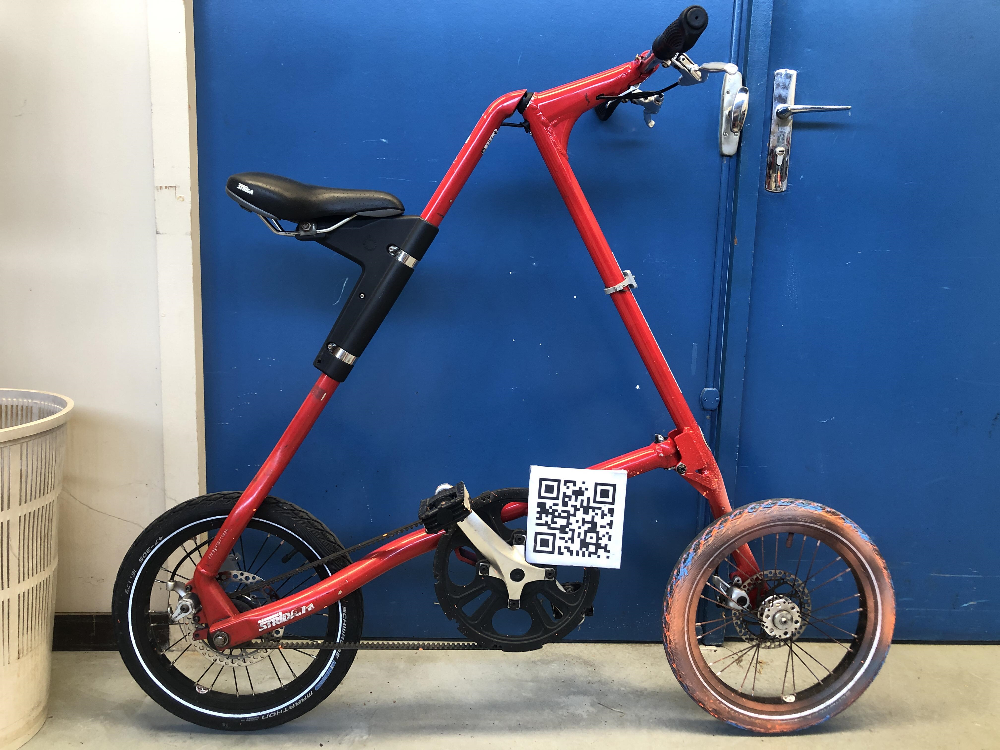</div>

#### Libraries

In [1]:
import cv2 # pip install opencv-python
import numpy as np # conda install numpy
import pyzbar.pyzbar as pyzbar # pip install git ; pip install git+https://github.com/sushil-bharati/pyzbar.git
# then you have to add the .dll files to your library folder
from scipy.optimize import minimize_scalar # conda install scipy

FileNotFoundError: Could not find module 'C:\Users\may\AppData\Local\anaconda3\envs\test_carac\Lib\site-packages\pyzbar\libiconv.dll' (or one of its dependencies). Try using the full path with constructor syntax.

## General code description

This code will make the translation from the pixel coordinates to the world coordinates $R_0$, illustrated in the next scheme :
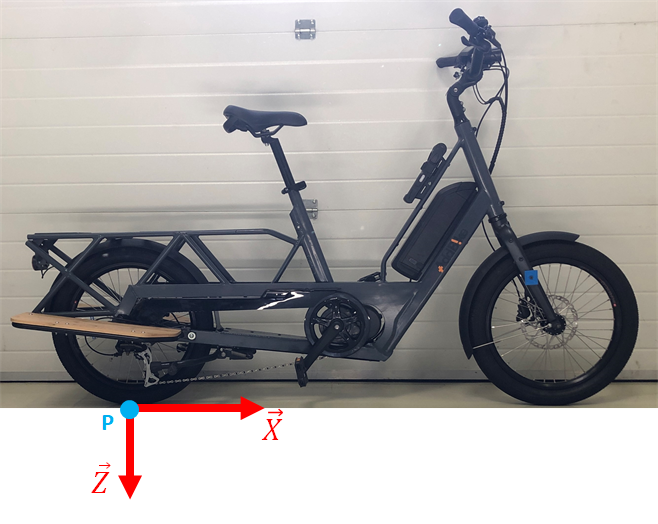

To do this, we need to identify 2 points on the bicycle, for the first one, you have to know its coordinates in the world reference frame $R_0$ (represented as $wheel\_coord$), and the second point will be used to determine the orientation angle for the frame rotation (represented as $real\_angle$).

## Definition of some variables specific to the part measured

Radius of wheels ($R\_wheel$) are measured at a given pneumatic pressure, with a person on the bicycle that the weight is known and a square positionned on a flat horizontal surface.

The bicycle's $wheelbase$ is the distance between the 2 contact points of the wheels and is measured with a tape measure.

Careful, $real\_angle$ must be defined from the $\overrightarrow{X}$ axis and expressed in the world reference frame. As an example, the green vector below makes a 111.6° angle. 

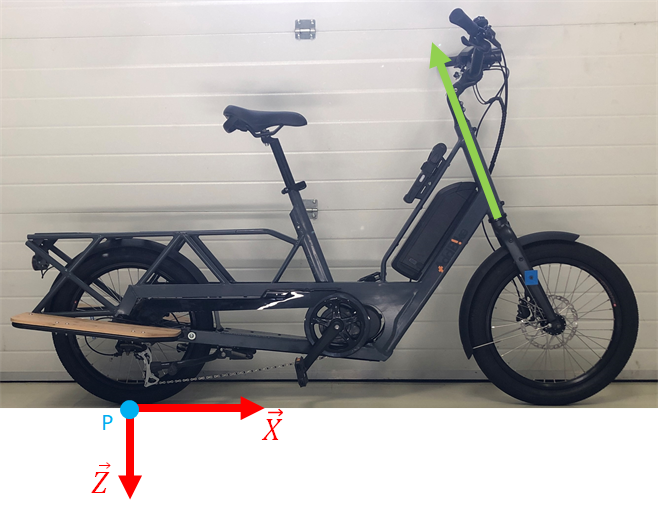

$origin$ parameter is used to modifiy the QR code position in the displayed image. 

When $origin$ = \[0,0\], the center of the reference frame is the upper left corner of the QR code (example below). 

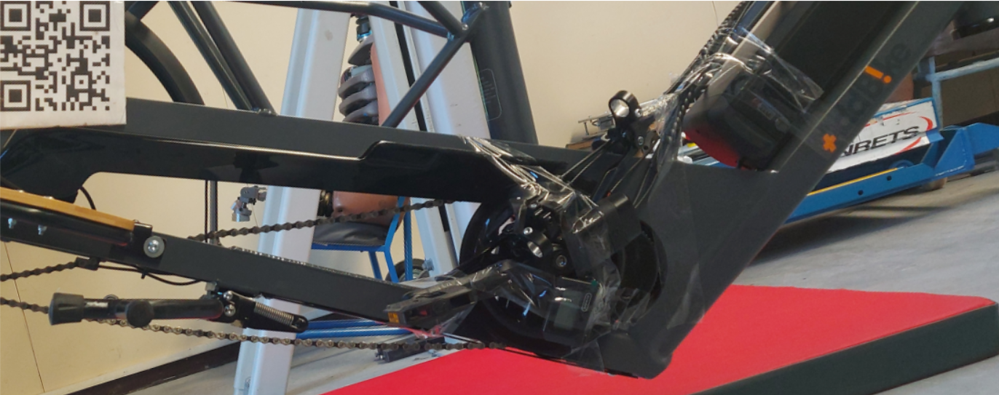

But if you modify its value, you can display the all part that you are measuring. 

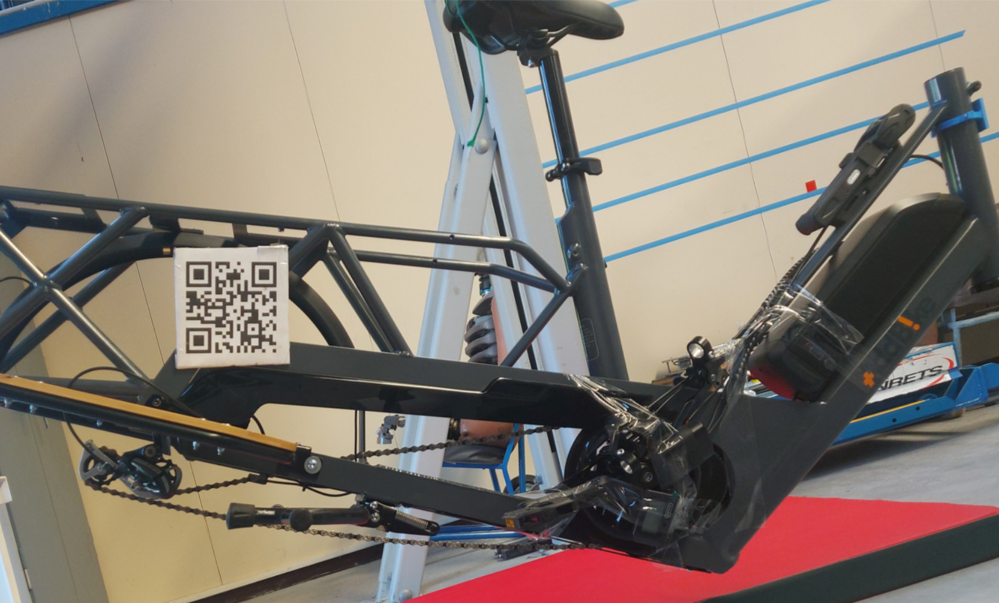

# <font color='red'>These variables are the ones you need to modify according to your part</font>

In [ ]:
print("You have to mofify this cell to enter the specific values of the part")

# first, we define the point of which we know the coordinates
R_wheel = 260 # mm
wheelbase = 0 # mm /!\ 0 if you are measuring the frame, wheelbase if you are measuring the front asembly

# then we define the axe which we know the orientation, we will select two points on this axe
# the axis used in this example is the one made by the wooden supports, which makes a -6.8° angle with the horizontal line
real_angle = -6.8 # °

# Then we modify the image to display all the part we are measuring
origin = [250,350]

Here we define the image number that we will use for the measurement. 

In [ ]:
L = [3,4,1]

To modify the size of the image, you have to modify this parameter.

In [ ]:
scale_percent = 20 # percent of original size

## Loop definition during which we select interesting points on each image

First of all, the loop used here detects the 4 vertices of the QR code and performs an image transformation so that the QR code has exactly the same dimensions as in reality. This step allows us to overcome any possible misalignments that could exist between our camera and the QR code. Then, the operator is asked to point 2 points on the image corresponding to the rope from which the part is suspended. We then recover the coordinates of these points in the image.

In [ ]:
list_x = []
list_y = []
list_a = []
list_b = []
for j in range(len(L)):
    file = "addbike/img" + str(L[j]) + ".JPG"
    img = cv2.imread(file)
    
    #======== Modifiying the size of the image for the display
    width = int(img.shape[1] * scale_percent / 100)
    height = int(img.shape[0] * scale_percent / 100)
    dim = (width, height)
    img = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)
    img_temp = img.copy()
    
    decodedObject = pyzbar.decode(img)
    points_1 = decodedObject[0].polygon
    
    points = np.zeros((4,2)) 
    points[0,0] = points_1[0][0]
    points[0,1] = points_1[0][1]
    points[3,0] = points_1[1][0]
    points[3,1] = points_1[1][1]
    points[2,0] = points_1[2][0]
    points[2,1] = points_1[2][1] 
    points[1,0] = points_1[3][0]
    points[1,1] = points_1[3][1]
    points = [points]
    
    if points is not None:
        nrOfPoints = len(points[0])
     
        for i in range(nrOfPoints):
            cv2.circle(img, (int(points[0][i][0]), int(points[0][i][1])), radius = 2, color = (255,0,0), thickness = 2)
        calib_pt_list = []
        cv2.imshow("Image",img) 
        
        def get_point(event, x, y, flags, param): # the function that get the coordinates of the pointing
            global calib_pt_list
            
            if event == cv2.EVENT_LBUTTONUP:
                calib_pt_list.append((x,y))
                cv2.circle(img,(x,y),radius = 1,color=(0, 0, 255), thickness=2)
                cv2.imshow("Image",img)
                # print("Point : ",(x,y))
        
        print("Select the 2 points of the rope, then press any key")    
        cv2.setMouseCallback("Image",get_point) # calling the pointing function
        cv2.imshow("Image",img)
        c = cv2.waitKey(0)
        cv2.destroyAllWindows()
        img = cv2.line(img,(calib_pt_list[0][0],calib_pt_list[0][1]),(calib_pt_list[1][0],calib_pt_list[1][1]),color=(0, 0, 255), thickness=1)
        # ======= Transformation matrix
        #Coordinates if the QR code vertices in the real world
        calib_pt0_real=[0,0]
        calib_pt1_real=[120,0] 
        calib_pt2_real=[120,120]
        calib_pt3_real=[0,120]
        image_line_pts_2 = np.float32([calib_pt0_real, calib_pt1_real, calib_pt2_real, calib_pt3_real])
        
        #Coordinates of the QR code vertices in the image
        image_line_pts_1 = np.float32(points[0])
        
        #Transformation to calibrate the image to the world reference frame
        dim = (2000,2500)
        
        image_line_pts_3 = np.float32(np.add(image_line_pts_2,origin))
        M = cv2.getPerspectiveTransform(image_line_pts_1,image_line_pts_3)
        calibrated_image=cv2.warpPerspective(img, M, dim)
        calibrated_image_temp = cv2.warpPerspective(img_temp, M, dim)
        x1 = calib_pt_list[0][0]
        x2 = calib_pt_list[1][0]
        y1 = calib_pt_list[0][1]
        y2 = calib_pt_list[1][1]
        
        real_point1 = np.dot(M,[x1,y1,1]) 
        real_point1 = real_point1 / real_point1[2]
        real_point2 = np.dot(M,[x2,y2,1])
        real_point2 = real_point2 / real_point2[2]
        
        final_img_temp = calibrated_image_temp.copy()

        calibrated_image = cv2.line(calibrated_image,(int(real_point1[0]),int(real_point1[1])),(int(real_point2[0]),int(real_point2[1])),color=(0, 255, 0), thickness=1)
        
        
        # ======= Getting the coordinates of the 2 points and computing the line's equation
        point1=real_point1
        point2=real_point2
        # we compute the a and b coefficients of the line 
        a1 = (point1[1]-point2[1])/(point1[0]-point2[0])
        list_a = np.append(list_a,a1)
        b1 = (point1[0]*point2[1]-point1[1]*point2[0])/(point1[0]-point2[0])
        list_b = np.append(list_b,b1)
        x1 = 0
        y1 = int(a1*x1+b1)
        x2 = 1000
        y2 = int(a1*x2+b1)
        
        list_x.append([x1,x2])
        
        list_y.append([y1,y2])

    else:
        print("QR code not detected")

In [ ]:
# Here we save an image for the final display
final_img = final_img_temp.copy()

Then we display all of the lines on one image to point the lines intersection, an example of an expected image is :
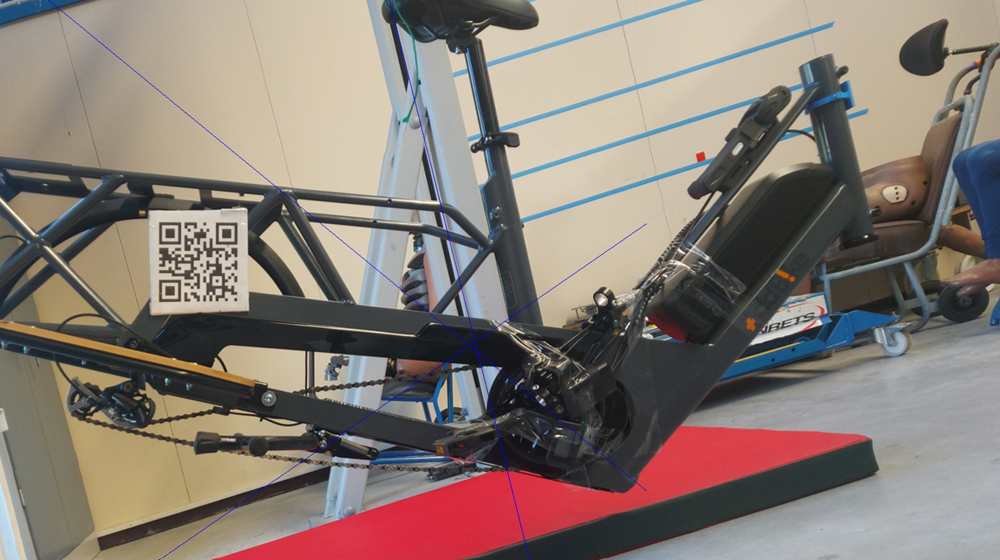

In [ ]:
for index_line in range(len(L)) :
    cv2.line(final_img,(list_x[index_line][0],list_y[index_line][0]),(list_x[index_line][1],list_y[index_line][1]),color=(255, 0, 0), thickness=1)

To get the center of gravity, we will point the 3 farthest lines intersections and get the mean point of the formed triangle. 

In [ ]:
# ========= Pointinf the triangle of the center of gravity

list_triangle = []
# ======== Getting the vertices of the polygone
i=0
def get_point_3(event, x, y, flags, param):
    global calib_pt_list,i
    if event == cv2.EVENT_LBUTTONUP:
        list_triangle.append((x,y))
        cv2.circle(final_img,(x,y),radius = 2,color=(255, 0, 0), thickness=1)
        cv2.imshow("Image finale",final_img)
        print("Point ",i," : ",(x,y))
        i+=1

print("Select the 3 opposite vertices of the polygone")
cv2.imshow('Image finale',final_img)
cv2.setMouseCallback('Image finale',get_point_3)
c = cv2.waitKey(0)
cv2.destroyAllWindows()

# ========= Building the list linked to the points of the triangle
x1 = list_triangle[0][0]
y1 = list_triangle[0][1]
x2 = list_triangle[1][0]
y2 = list_triangle[1][1]
x3 = list_triangle[2][0]
y3 = list_triangle[2][1]

# ======== Triangle mean point
moy_x = (x1+x2+x3)/3
moy_y = (y1+y2+y3)/3

# ======== Getting the farthest point from the mean one
norm1 = np.linalg.norm([moy_x-x1,moy_y-y1])
norm2 = np.linalg.norm([moy_x-x2,moy_y-y2])
norm3 = np.linalg.norm([moy_x-x3,moy_y-y3])

rad = np.amax((norm1,norm2,norm3))
print()
print("Coordinates of the center of gravity : ", (int(moy_x - origin[0]),int(moy_y - origin[1]))," mm")
print("Circle radius : ", int(rad)," mm")
cv2.circle(final_img,(int(moy_x),int(moy_y)),radius = int(rad),color=(0, 255, 0), thickness=2)
cv2.imshow('Final image',final_img)
c = cv2.waitKey(0)
cv2.destroyAllWindows()

Here you should have an image like this one : 
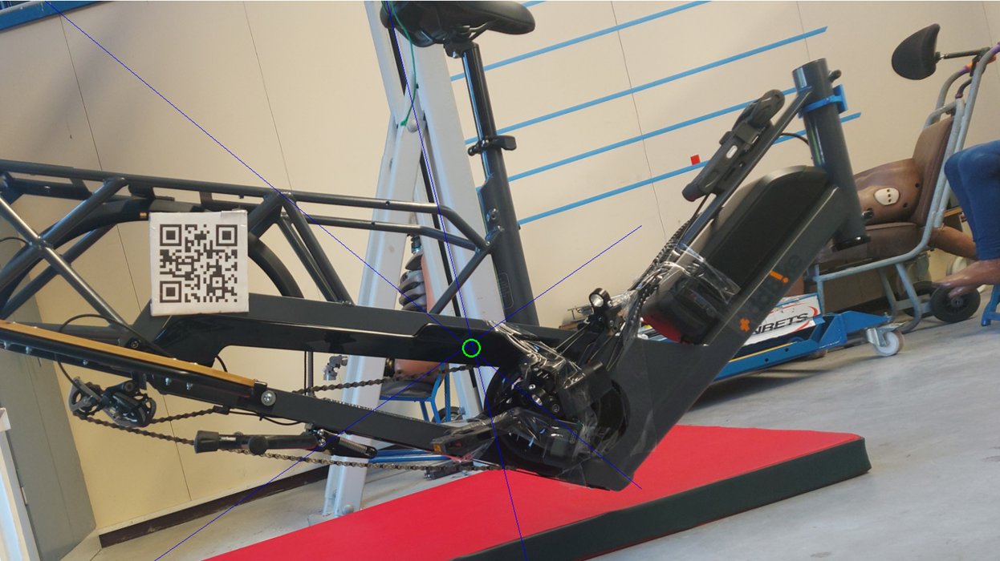

The coordinates of the center of gravity are expressed on the reference frame linked to the QR code that we know the real dimensions.
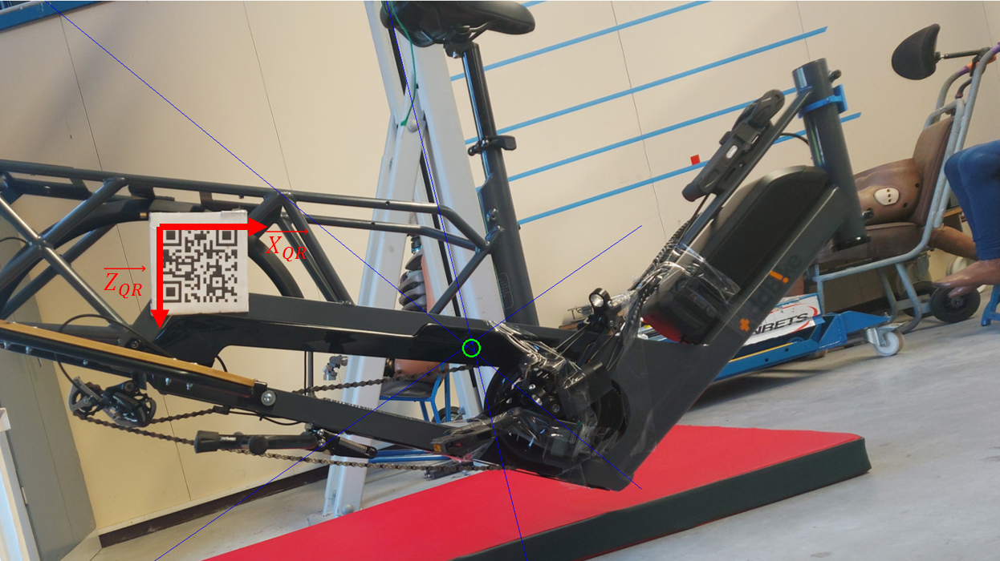

## Changing the reference to define the center of gravity position on the world reference frame


In the litterature, the reference frame is centered on the contact point of the rear wheel, the $\overrightarrow{X}$ axis is aligned with the roll axis and $\overrightarrow{Z}$ axis with the vertical oriented to the bottom : 
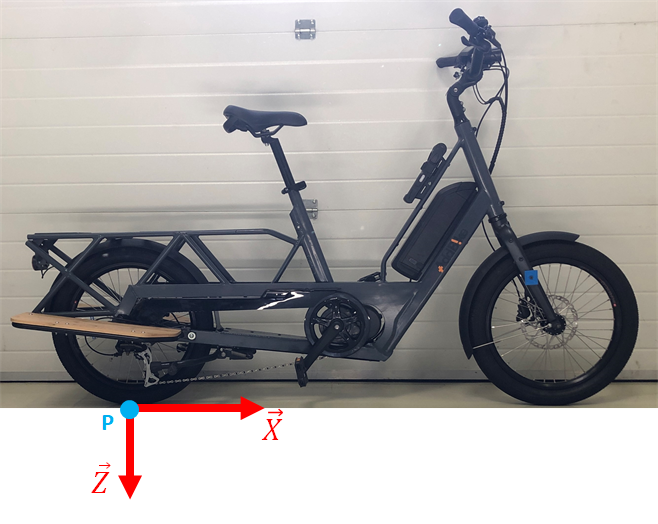

Now that we have the coordinates of the center of gravity in the reference frame linked to the QR code, we have to define the rotation and translation to realize to get from the QR code reference to the world reference frame.  

For the translation, we need a point for which we know the coordinates in the world reference frame, points easy to indetify are wheel centers :  \[$wheelbase$;$R_0$\]. The point needed is then the place where the wheel axis will be once the wheel is on the bike. 

In [ ]:
# ========== Wheel center
final_img_new = calibrated_image_temp
pos_roue = [0,0]
def get_point_4(event, x, y, flags, param):
    global pos_roue
    if event == cv2.EVENT_LBUTTONUP:
        pos_roue = np.subtract([x,y],origin)
        cv2.circle(final_img_new,(x,y),radius = 2,color=(255, 0, 0), thickness=1)
        cv2.imshow("Final image",final_img_new)
        # print("Coordinate of wheel base in the QR code reference : ",pos_roue)


print("Select wheel center")
cv2.imshow('Final image',final_img_new)
cv2.setMouseCallback('Final image',get_point_4)
c = cv2.waitKey(0)
cv2.destroyAllWindows()

The past few lines as been used to determine the green vector on the following figure. 
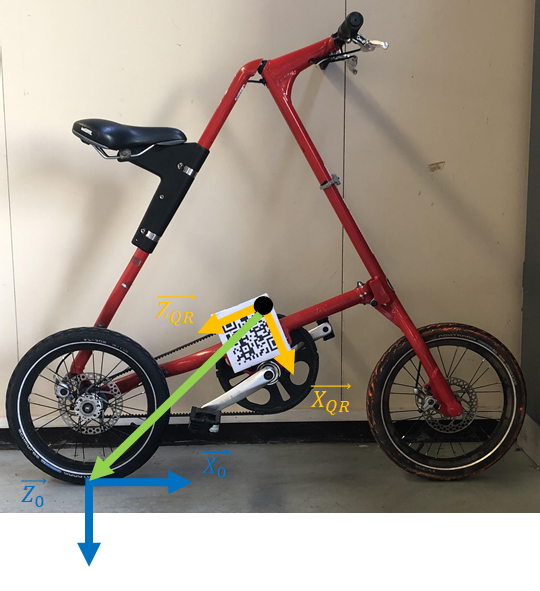

Then, it is necessary to determine the orientation of the QR reference $R_{QRcode}$ compared to the wolrd reference $R_0$.
To do this, we will use the last point and an other one which we will point to define a new vector. 

For the Ucargo bicycle (the cargo one), we measured the angle of the wooden plates at the rear of the bicycle. This angle is -6.8° from horizontal; represented in $real_angle$ variable. so we have to select an other point, aligned with the plate and that pass through the center of the rear wheel. 

Poitning this new axis permits ourself to define the rotation angle between $R_0$ and $R_{QR}$ :
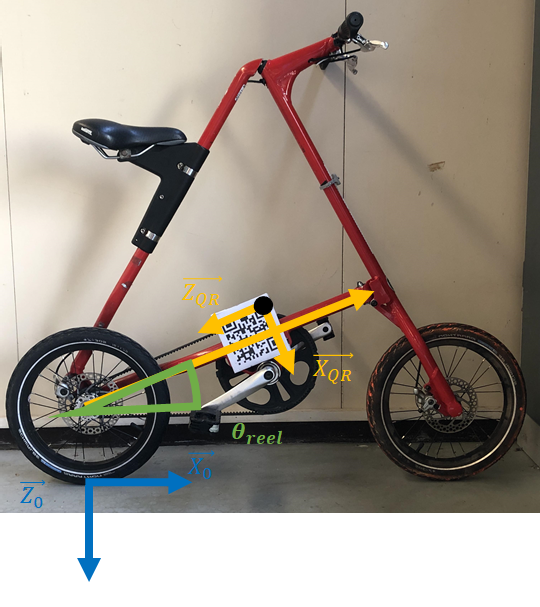

In [ ]:
pos_tube_diag = [0,0]
def get_point_5(event, x, y, flags, param):
	global pos_tube_diag
	if event == cv2.EVENT_LBUTTONUP:
		pos_tube_diag = np.subtract([x,y],origin)
		cv2.circle(final_img_new,(x,y),radius = 2,color=(255, 0, 0), thickness=1)
		cv2.imshow("Final image",final_img_new)
		# print("Coordinates of the clicked point in the QR code reference : ",pos_tube_diag)
        
print("Select an other point of the tube")
cv2.imshow('Final image',final_img_new)
cv2.setMouseCallback('Final image',get_point_5)
c = cv2.waitKey(0)
cv2.destroyAllWindows()

Now that we have both points for defining the rotation and translation linked to the reference change, we can build the transformation matrix to convert pixel coordinates to world coordinates. 

Parameters to modify for each parts are : $real\_angle$, $R\_wheel$ et $wheelbase$. 

In [ ]:
def cgt_rep(vec) :
    global real_angle, empattement, R_roue
    x2 = pos_tube_diag[0]
    x1 = pos_roue[0]
    y2 = pos_tube_diag[1]
    y1 = pos_roue[1]
     
    angle = np.arctan2((y2-y1),(x2-x1))
  
    # print(angle*180/np.pi)
    real_angle_temp = - real_angle  * np.pi/180
    angle_rota =  real_angle_temp - angle
    # print("angle_rota : ",angle_rota*180/np.pi)
    R = np.zeros((2,2))
    R[0,0] = np.cos(angle_rota)
    R[0,1] = -np.sin(angle_rota)
    R[1,0] = np.sin(angle_rota)
    R[1,1] = np.cos(angle_rota)
    vec = np.subtract(vec,origin)
    vec = np.subtract(vec,[x1,y1])
    vec = R @ vec
    vec[1]=-vec[1] 
    vec = np.add(vec,[wheelbase,R_wheel])
    return vec

So we can display the coordinates of the center of gravity in the world reference frame $R_0$ : 

In [ ]:
print("Coordinates of the center of gravity in the world reference frame :")
print(cgt_rep([moy_x,moy_y]))